# IMPORTING DATASET

  0%|          | 0/1101 [00:00<?, ?it/s]

DataPrep Report
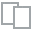
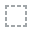
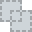
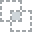
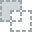
...
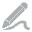
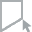
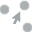
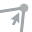
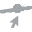

In [1]:
# Ignoring the warnings
import warnings
warnings.filterwarnings("ignore")
from dataprep.eda import create_report
import pandas as pd
# Reading the excel file
df = pd.read_excel("Data_Train.xlsx")
create_report(df)

In [2]:
# Getting the dataset info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10683 non-null  object
 1   Date_of_Journey  10683 non-null  object
 2   Source           10683 non-null  object
 3   Destination      10683 non-null  object
 4   Route            10682 non-null  object
 5   Dep_Time         10683 non-null  object
 6   Arrival_Time     10683 non-null  object
 7   Duration         10683 non-null  object
 8   Total_Stops      10682 non-null  object
 9   Additional_Info  10683 non-null  object
 10  Price            10683 non-null  int64 
dtypes: int64(1), object(10)
memory usage: 918.2+ KB


In [3]:
# Checking number of null values in each column
df.isnull().sum()

Airline            0
Date_of_Journey    0
Source             0
Destination        0
Route              1
Dep_Time           0
Arrival_Time       0
Duration           0
Total_Stops        1
Additional_Info    0
Price              0
dtype: int64

# PREPROCESSING DATASET

In [4]:
# Getting the journey day and month from the Date_of_Journey Column
df.Date_of_Journey=df.Date_of_Journey.str.split('/')
print(df.Date_of_Journey)
df['Date']=df.Date_of_Journey.str[0]
df['Month']=df.Date_of_Journey.str[1]
df['Year']=df.Date_of_Journey.str[2]

0        [24, 03, 2019]
1         [1, 05, 2019]
2         [9, 06, 2019]
3        [12, 05, 2019]
4        [01, 03, 2019]
              ...      
10678     [9, 04, 2019]
10679    [27, 04, 2019]
10680    [27, 04, 2019]
10681    [01, 03, 2019]
10682     [9, 05, 2019]
Name: Date_of_Journey, Length: 10683, dtype: object


In [5]:
# Splitting the Route column and creating the 6 City column one for each
df.Route = df.Route.str.split('→')
df['City1'] = df.Route.str[0] 
df['City2'] = df.Route.str[1] 
df['City3'] = df.Route.str[2] 
df['City4'] = df.Route.str[3] 
df['City5'] = df.Route.str[4] 
df['City6'] = df.Route.str[5]

In [6]:
# Getting the Departure time in hour and minutes from the Dep_Time Column
df.Dep_Time=df.Dep_Time.str.split(':')
df['Dep_Time_Hour']=df.Dep_Time.str[0]
df['Dep_Time_Min']=df.Dep_Time.str[1]

In [7]:
# Getting Arrival date, time in hour and minutes from Arrival_Time column
df.Arrival_Time=df.Arrival_Time.str.split(' ')
df['Arrival_date'] = df.Arrival_Time.str[1]
df['Time_Of_Arrival']=df.Arrival_Time.str[0]
df['Time_Of_Arrival']=df.Time_Of_Arrival.str.split(':')
df['Arrival_Time_Hour']=df.Time_Of_Arrival.str[0]
df['Arrival_Time_Min']=df.Time_Of_Arrival.str[1]

In [8]:
# Getting the duration of the flight
df.Duration = df.Duration.str.split(' ')
df['Travel_hours'] = df. Duration.str[0]
df['Travel_hours'] = df['Travel_hours'].str.split('h')
df['Travel_hours'] = df['Travel_hours'].str[0]
df.Travel_hours = df. Travel_hours
df['Travel_mins'] = df. Duration.str[1]
df.Travel_mins = df. Travel_mins.str.split('m')
df.Travel_mins = df. Travel_mins.str[0]

In [9]:
# Replacing the non-stop entries from Total_Stops column with 0 and then storing that number in the column
df.Total_Stops.replace('non-stop', '0', inplace = True)
df.Total_Stops = df.Total_Stops.str.split('')
df.Total_Stops = df.Total_Stops.str[0]

In [10]:
# Replacing the No Info entries with No info in Additional_Info column in order to maintain uniformity
df.Additional_Info.replace('No Info', 'No info', inplace=True)

In [11]:
# Getting the sum of number of null values in each column
df.isnull().sum()

Airline                  0
Date_of_Journey          0
Source                   0
Destination              0
Route                    1
Dep_Time                 0
Arrival_Time             0
Duration                 0
Total_Stops              1
Additional_Info          0
Price                    0
Date                     0
Month                    0
Year                     0
City1                    1
City2                    1
City3                 3492
City4                 9117
City5                10637
City6                10682
Dep_Time_Hour            0
Dep_Time_Min             0
Arrival_date          6348
Time_Of_Arrival          0
Arrival_Time_Hour        0
Arrival_Time_Min         0
Travel_hours             0
Travel_mins           1032
dtype: int64

In [12]:
# Dropping city 4, 5 and city 6 since most of their entries are null 
df.drop('City4',axis=1,inplace=True)
df.drop('City5',axis=1,inplace=True)
df.drop('City6',axis=1,inplace=True)

In [13]:
df.isnull().sum()

Airline                 0
Date_of_Journey         0
Source                  0
Destination             0
Route                   1
Dep_Time                0
Arrival_Time            0
Duration                0
Total_Stops             1
Additional_Info         0
Price                   0
Date                    0
Month                   0
Year                    0
City1                   1
City2                   1
City3                3492
Dep_Time_Hour           0
Dep_Time_Min            0
Arrival_date         6348
Time_Of_Arrival         0
Arrival_Time_Hour       0
Arrival_Time_Min        0
Travel_hours            0
Travel_mins          1032
dtype: int64

In [14]:
# Checking if there is a row whose city1 column has null value
df[df['City1'].isnull()]

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,...,City2,City3,Dep_Time_Hour,Dep_Time_Min,Arrival_date,Time_Of_Arrival,Arrival_Time_Hour,Arrival_Time_Min,Travel_hours,Travel_mins
9039,Air India,"[6, 05, 2019]",Delhi,Cochin,NaN,"[09, 45]","[09:25, 07, May]","[23h, 40m]",NaN,No info,...,NaN,NaN,09,45,07,"[09, 25]",09,25,23,40


In [15]:
# Removing the row whose City 1 column is null
df.drop(index=9039, inplace = True, axis=0)

In [16]:
# Filling City3 as None, since the missing values are less, we will assign a separate category to this column as None
df['City3'].fillna('None', inplace = True)
# Filling the null values in Arrival date with values in Departure date, since the Nan #values are those dates which departed and arrived on the same date
df['Arrival_date'].fillna(df['Date'], inplace = True)
# Filling Nan values in Travel mins as 0, since the minutes df is not valid for these (reached in hour units)
df['Travel_mins'].fillna(0, inplace = True)


In [17]:
# Dropping this row because of incorrect entry of data
df.drop(index=6474, inplace= True, axis=0)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10681 entries, 0 to 10682
Data columns (total 25 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Airline            10681 non-null  object
 1   Date_of_Journey    10681 non-null  object
 2   Source             10681 non-null  object
 3   Destination        10681 non-null  object
 4   Route              10681 non-null  object
 5   Dep_Time           10681 non-null  object
 6   Arrival_Time       10681 non-null  object
 7   Duration           10681 non-null  object
 8   Total_Stops        10681 non-null  object
 9   Additional_Info    10681 non-null  object
 10  Price              10681 non-null  int64 
 11  Date               10681 non-null  object
 12  Month              10681 non-null  object
 13  Year               10681 non-null  object
 14  City1              10681 non-null  object
 15  City2              10681 non-null  object
 16  City3              10681 non-null  objec

In [18]:
type(df.Total_Stops)

pandas.core.series.Series

In [19]:
# Converting the datatypes of following column to int 
df.Date = df.Date.astype('int64') 
df.Month = df.Month.astype('int64') 
df.Year = df.Year.astype('int64') 
df.Dep_Time_Hour = df.Dep_Time_Hour.astype('int64') 
df.Dep_Time_Min = df.Dep_Time_Min.astype('int64') 
df.Arrival_date = df.Arrival_date.astype('int64') 
df.Arrival_Time_Hour = df.Arrival_Time_Hour.astype('int64') 
df.Arrival_Time_Min = df.Arrival_Time_Min.astype('int64') 
df.Travel_hours = df. Travel_hours.astype('int64') 
df.Travel_mins = df.Travel_mins.astype('int64')

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10681 entries, 0 to 10682
Data columns (total 25 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Airline            10681 non-null  object
 1   Date_of_Journey    10681 non-null  object
 2   Source             10681 non-null  object
 3   Destination        10681 non-null  object
 4   Route              10681 non-null  object
 5   Dep_Time           10681 non-null  object
 6   Arrival_Time       10681 non-null  object
 7   Duration           10681 non-null  object
 8   Total_Stops        10681 non-null  object
 9   Additional_Info    10681 non-null  object
 10  Price              10681 non-null  int64 
 11  Date               10681 non-null  int64 
 12  Month              10681 non-null  int64 
 13  Year               10681 non-null  int64 
 14  City1              10681 non-null  object
 15  City2              10681 non-null  object
 16  City3              10681 non-null  objec

In [21]:
#Creating list of different types of columns
categorical = ['Airline', 'Source', 'Destination', 'Additional_Info', 'City1', 'City2', 'City3'] 
numerical = ['Total_Stops', 'Date', 'Month', 'Year', 'Dep_Time_Hour', 'Dep_Time_Min', 'Arrival_date',
'Arrival_Time_Hour', 'Arrival_Time_Min', 'Travel_hours', 'Travel_mins']

# PLOTTING GRAPH BEFORE REMOVING SKEWNESS AND BEFORE SCALING AND ENCODING DATASET

<function matplotlib.pyplot.show(close=None, block=None)>

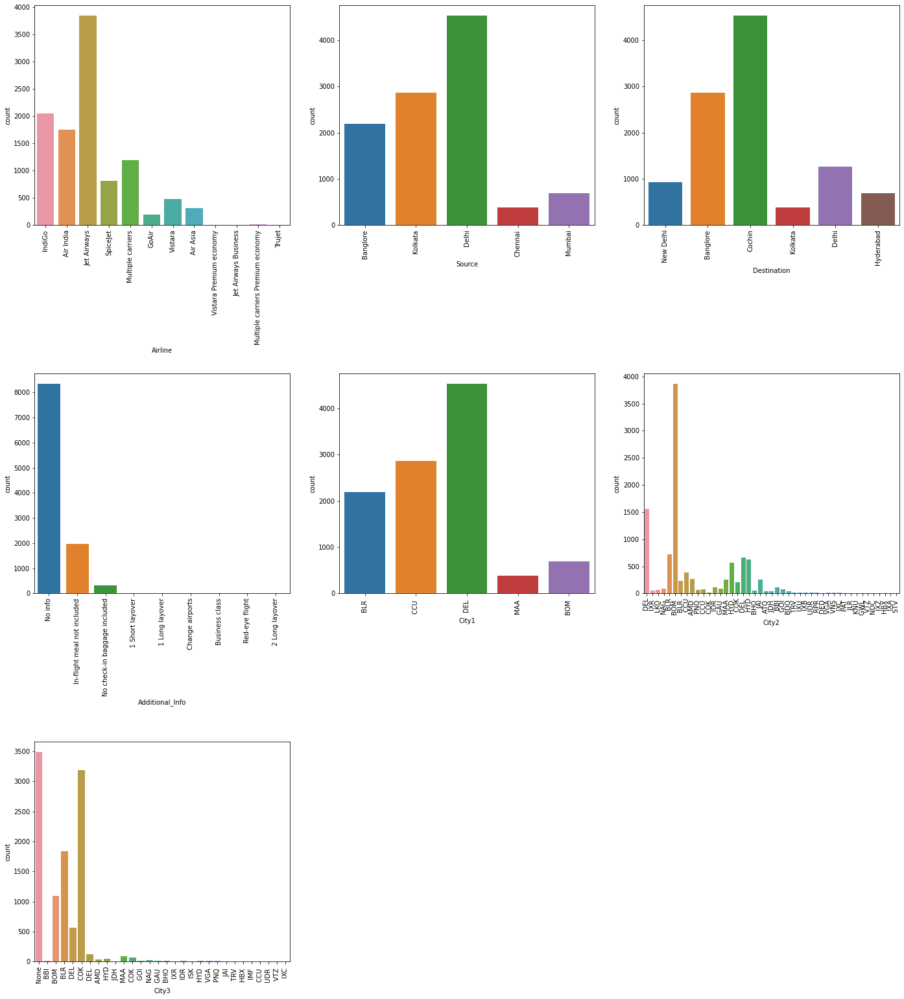

In [22]:
# Plotting the countplots of every categorical data
import seaborn as sns
import matplotlib.pyplot as plt
c=1
plt.figure(figsize=(20,45))
for i in categorical:
    plt. subplot(6,3,c) 
    sns.countplot(df[i]) 
    plt.xticks(rotation = 90) 
    plt.tight_layout(pad = 3.0)
    c=c+1 
plt.show

<AxesSubplot:xlabel='Price', ylabel='Density'>

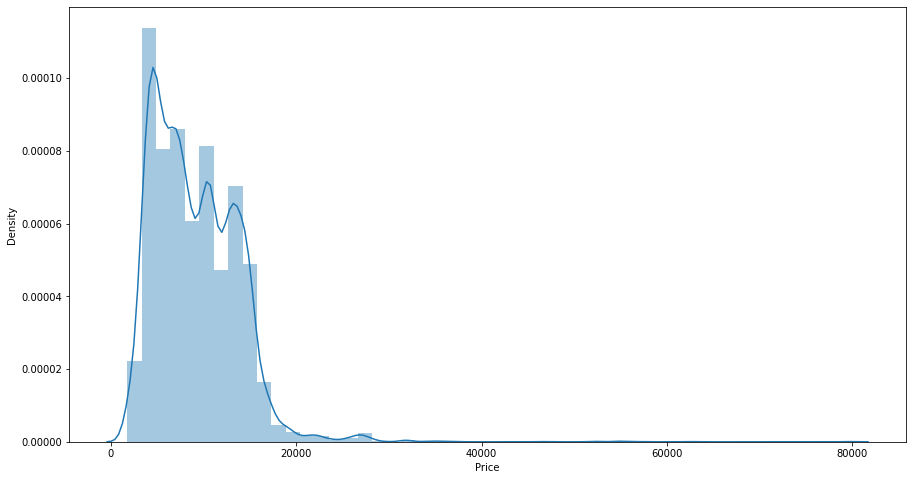

In [23]:
# Checking the distribution of price column
plt.figure(figsize = (15,8)) 
sns.distplot(df.Price)

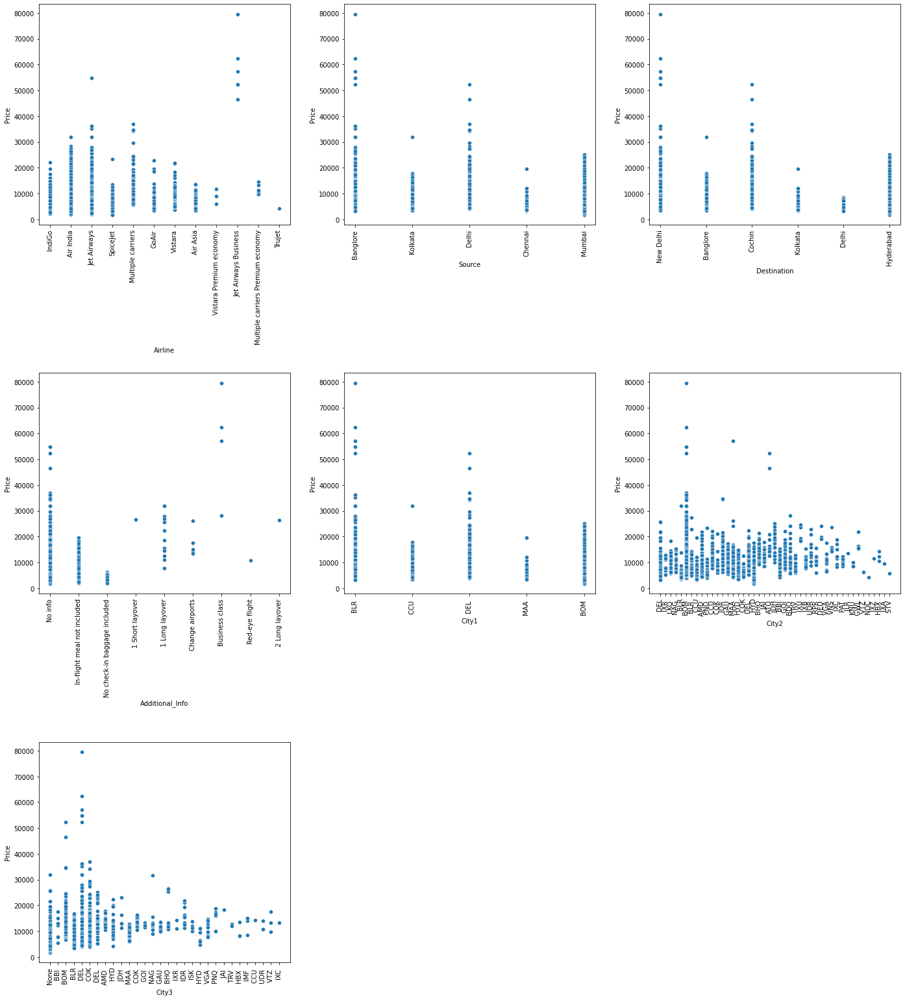

In [24]:
# Checking for relation of prices with categorical data
c=1
plt.figure(figsize=(20,45))
for i in categorical:
    plt. subplot(6,3,c) 
    sns.scatterplot(x = df[i], y = df.Price ) 
    plt.xticks (rotation = 90) 
    plt.tight_layout(pad = 3.0) 
    c=c+1 
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

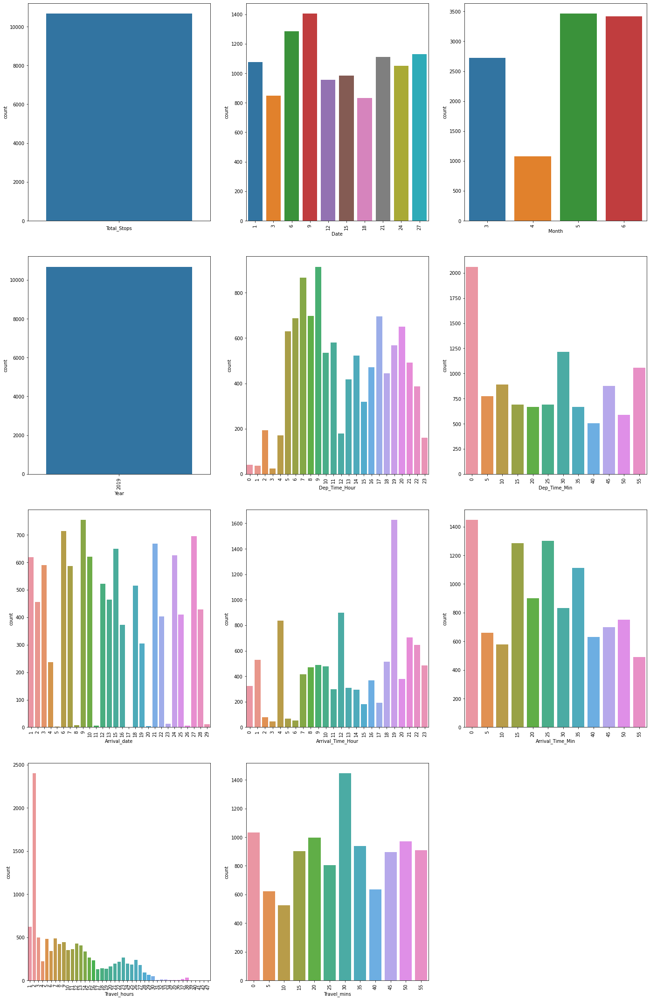

In [25]:
# Plotting the countplot of numerical data
c=1
plt.figure(figsize=(20,45))
for i in numerical:
    plt. subplot(6,3,c) 
    sns.countplot(df[i]) 
    plt.xticks(rotation = 90) 
    plt.tight_layout(pad = 3.0)
    c=c+1 
plt.show

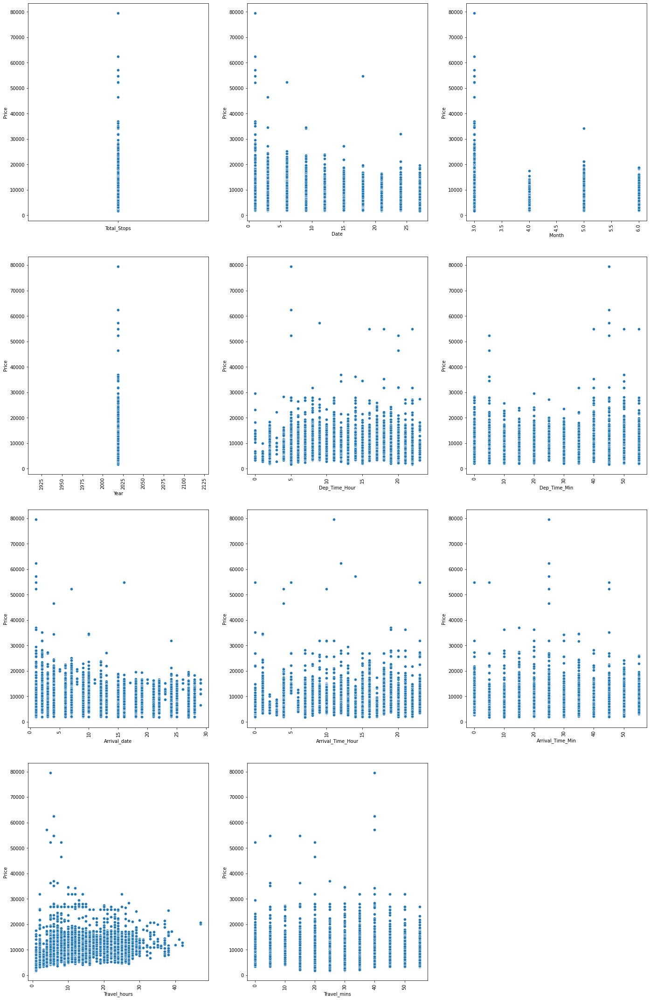

In [26]:
# Plotting the numerical data with price
c=1
plt.figure(figsize=(20,45))
for i in numerical:
    plt. subplot(6,3,c) 
    sns.scatterplot(x = df[i], y = df.Price ) 
    plt.xticks (rotation = 90) 
    plt. tight_layout(pad =3.0)
    c=c+1 
plt.show()

In [27]:
# Treating the skewness in our dataset which helps us in fitting our data in symmetric manner
df.skew()

Price                1.813100
Date                 0.117998
Month               -0.387625
Year                 0.000000
Dep_Time_Hour        0.113075
Dep_Time_Min         0.167415
Arrival_date         0.119494
Arrival_Time_Hour   -0.370033
Arrival_Time_Min     0.110928
Travel_hours         0.851156
Travel_mins         -0.090842
dtype: float64

In [28]:
# Removing the skewness
import numpy as np
df.Travel_hours=np.log(df.Travel_hours)
df.Travel_hours.skew()

-0.2659940694368634

In [29]:
# Encoding the categorical data with the help of LabelEncoder
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
df = df.apply(lambda col: le.fit_transform(col.astype(str)), axis=0, result_type='expand')


In [30]:
df.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,...,City2,City3,Dep_Time_Hour,Dep_Time_Min,Arrival_date,Time_Of_Arrival,Arrival_Time_Hour,Arrival_Time_Min,Travel_hours,Travel_mins
0,3,24,0,5,18,211,233,240,0,7,...,13,29,15,3,13,12,1,1,1,10
1,1,6,3,0,84,31,913,334,0,7,...,25,1,19,10,0,104,5,2,6,4
2,4,43,2,1,118,70,412,117,0,7,...,32,4,23,4,1,30,18,4,18,0
3,3,10,3,0,91,164,1324,310,0,7,...,34,3,10,9,3,217,16,5,4,4
4,3,0,0,5,29,149,1237,302,0,7,...,34,8,8,10,0,194,14,6,3,8


In [31]:
# Bringing the data to a standard scale since there exist some column with low values and some with very high values therefore bringing them to 
# a common scale will make learning easy for the model
from sklearn.preprocessing import StandardScaler 
sc = StandardScaler() 
ds_x = df.drop('Price', axis = 1)
y = df['Price']
dataset = sc.fit_transform(ds_x)
x = pd.DataFrame(df, columns=ds_x.columns)
x

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,...,City2,City3,Dep_Time_Hour,Dep_Time_Min,Arrival_date,Time_Of_Arrival,Arrival_Time_Hour,Arrival_Time_Min,Travel_hours,Travel_mins
0,3,24,0,5,18,211,233,240,0,7,...,13,29,15,3,13,12,1,1,1,10
1,1,6,3,0,84,31,913,334,0,7,...,25,1,19,10,0,104,5,2,6,4
2,4,43,2,1,118,70,412,117,0,7,...,32,4,23,4,1,30,18,4,18,0
3,3,10,3,0,91,164,1324,310,0,7,...,34,3,10,9,3,217,16,5,4,4
4,3,0,0,5,29,149,1237,302,0,7,...,34,8,8,10,0,194,14,6,3,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10678,0,41,3,0,64,183,1259,236,0,7,...,5,29,11,11,27,204,15,4,1,5
10679,1,29,3,0,64,193,1309,237,0,7,...,5,29,13,8,18,215,16,3,1,6
10680,4,29,0,2,18,58,829,288,0,7,...,13,29,22,3,18,83,3,3,2,0
10681,10,0,0,5,18,92,938,238,0,7,...,13,29,3,5,0,114,6,1,1,7


# PLOTTING GRAPH AFTER REMOVING SKEWNESS, SCALING AND ENCODING THE DATASET

<function matplotlib.pyplot.show(close=None, block=None)>

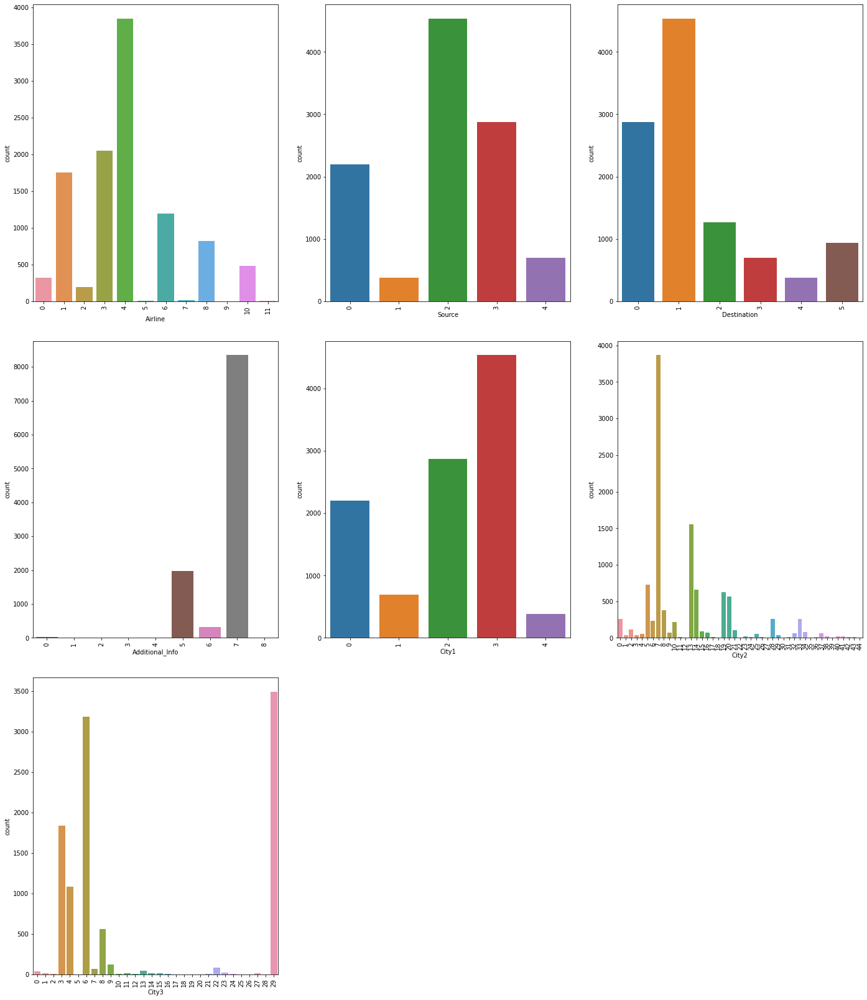

In [32]:
# Plotting the countplots of every categorical data
import seaborn as sns
import matplotlib.pyplot as plt
c=1
plt.figure(figsize=(20,45))
for i in categorical:
    plt. subplot(6,3,c) 
    sns.countplot(df[i]) 
    plt.xticks(rotation = 90) 
    plt.tight_layout(pad = 3.0)
    c=c+1 
plt.show

<AxesSubplot:xlabel='Price', ylabel='Density'>

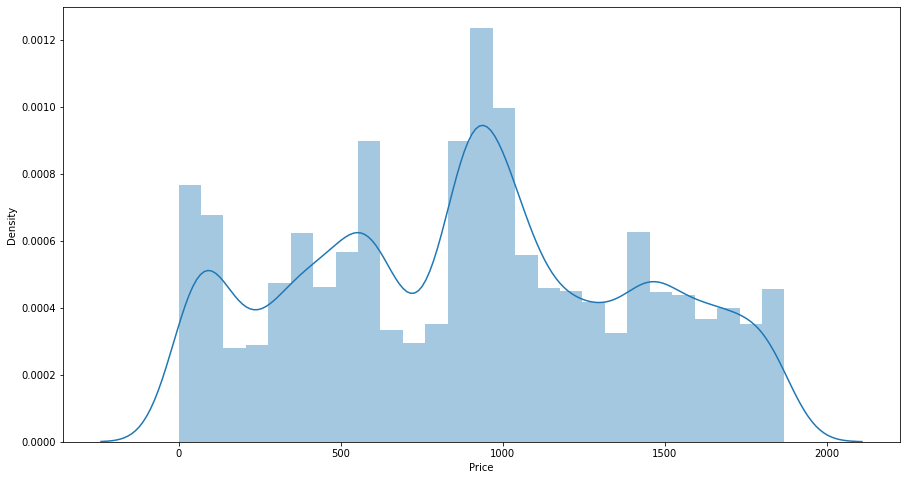

In [33]:
# Checking the distribution of price column
plt.figure(figsize = (15,8)) 
sns.distplot(df.Price)

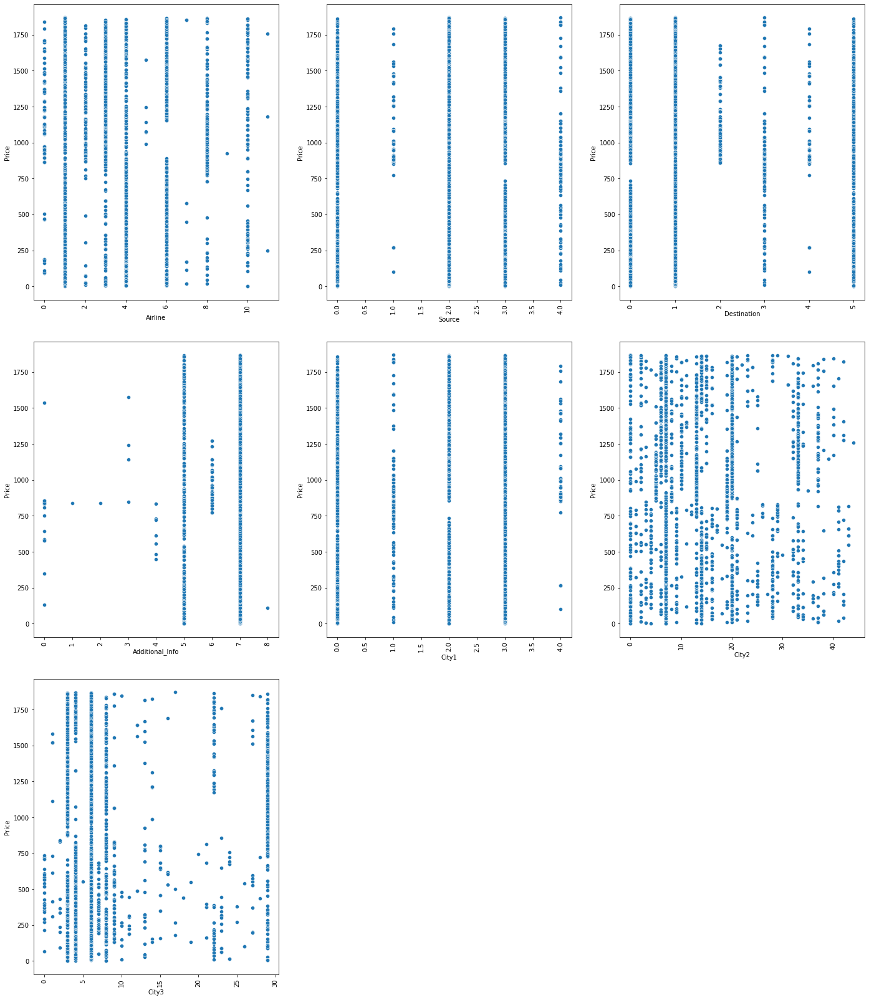

In [34]:
# Checking for relation of prices with categorical data
c=1
plt.figure(figsize=(20,45))
for i in categorical:
    plt. subplot(6,3,c) 
    sns.scatterplot(x = df[i], y = df.Price ) 
    plt.xticks (rotation = 90) 
    plt.tight_layout(pad = 3.0) 
    c=c+1 
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

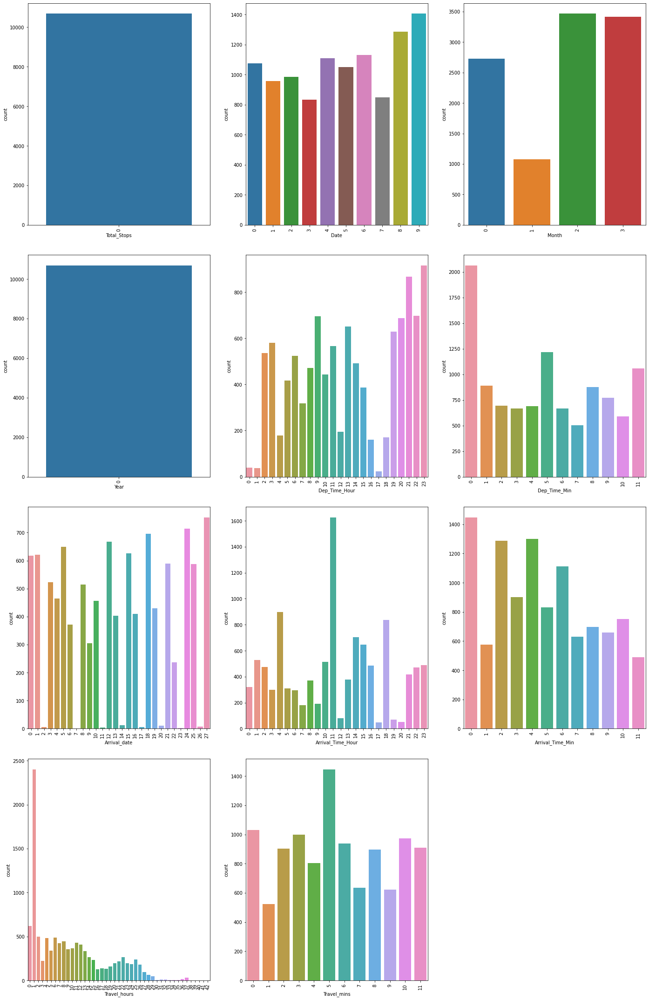

In [35]:
# Plotting the countplot of numerical data
c=1
plt.figure(figsize=(20,45))
for i in numerical:
    plt. subplot(6,3,c) 
    sns.countplot(df[i]) 
    plt.xticks(rotation = 90) 
    plt.tight_layout(pad = 3.0)
    c=c+1 
plt.show

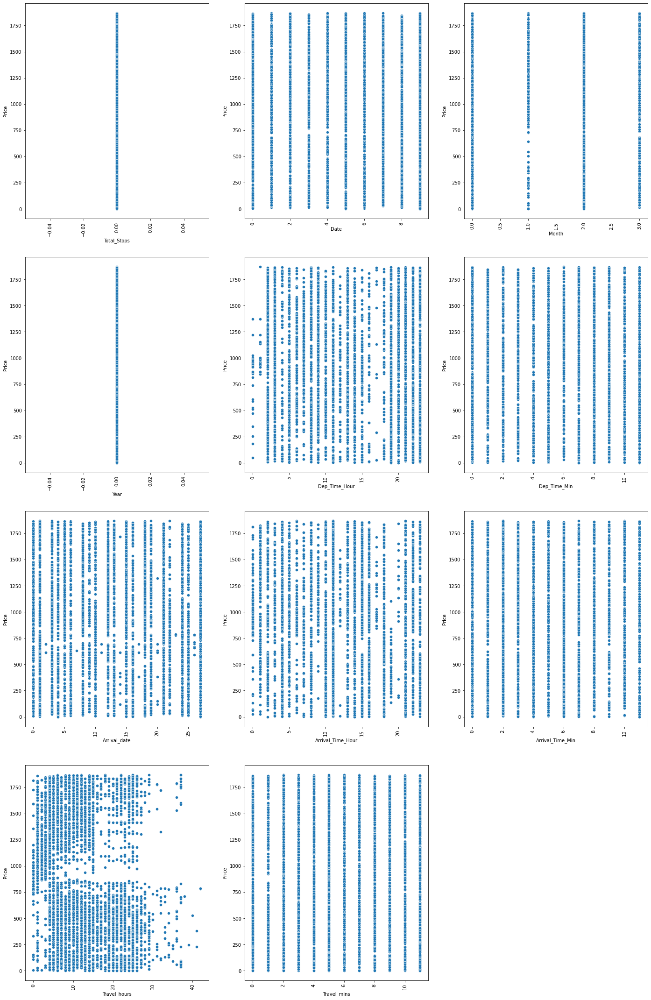

In [36]:
# Plotting the numerical data with price
c=1
plt.figure(figsize=(20,45))
for i in numerical:
    plt. subplot(6,3,c) 
    sns.scatterplot(x = df[i], y = df.Price ) 
    plt.xticks (rotation = 90) 
    plt. tight_layout(pad =3.0)
    c=c+1 
plt.show()

# TRAINING DIFFERENT MODEL

In [37]:
from sklearn.model_selection import train_test_split 
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
# Splitting the data into training and test set
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.3, random_state=42) 

In [38]:
# Importing the randon forest regressor, adaboost regressor and gradient boosting regressor from the sklearn library
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor
rfr = RandomForestRegressor()
ad = AdaBoostRegressor() 
gd = GradientBoostingRegressor()

for i in [rfr, ad, gd]:
    i.fit(x_train, y_train) 
    pred=i.predict(x_test) 
    test_score=r2_score(y_test, pred) 
    train_score=r2_score(y_train, i.predict(x_train))
    if abs(train_score - test_score) <= 8.2:
        print(i) 
        print('R2 score is ',r2_score(y_test, pred)) 
        print('R2 for train data', r2_score(y_train, i.predict(x_train)))
        print('Mean absolute error is ', mean_absolute_error(y_test, pred)) 
        print('Mean squared error is ', mean_squared_error(y_test, pred))
        print('Root mean squared error is' ,(mean_squared_error(y_test, pred, squared=False)))
        print("---------------------------------------------------")

RandomForestRegressor()
R2 score is  0.6851164520047384
R2 for train data 0.94527291780886
Mean absolute error is  143.39674124136394
Mean squared error is  79879.04475938038
Root mean squared error is 282.6288109152717
---------------------------------------------------
AdaBoostRegressor()
R2 score is  0.1756287871459582
R2 for train data 0.17884726784581195
Mean absolute error is  372.2492057224923
Mean squared error is  209124.88260867674
Root mean squared error is 457.3017413138471
---------------------------------------------------
GradientBoostingRegressor()
R2 score is  0.4169845183631412
R2 for train data 0.44234939667615414
Mean absolute error is  287.7035846372429
Mean squared error is  147898.23110664127
Root mean squared error is 384.5753906669553
---------------------------------------------------


In [39]:
# Importing cross_val_score form model_selection
from sklearn.model_selection import cross_val_score
for i in range(2,9):
    cv=cross_val_score(rfr,x,y,cv=i)
    print(rfr,cv.mean())

RandomForestRegressor() 0.6557393266875449
RandomForestRegressor() 0.6763424010868255
RandomForestRegressor() 0.6884136449312157
RandomForestRegressor() 0.6906960440416979
RandomForestRegressor() 0.6939310856045514
RandomForestRegressor() 0.694329435418999
RandomForestRegressor() 0.6971860315965586


In [40]:
for i in range(2,9):
    cv=cross_val_score(gd,x,y,cv=i)
    print(gd,cv.mean())

GradientBoostingRegressor() 0.389130107686058
GradientBoostingRegressor() 0.40694187930323006
GradientBoostingRegressor() 0.4056067026118615
GradientBoostingRegressor() 0.4163184439664419
GradientBoostingRegressor() 0.4083615384841774
GradientBoostingRegressor() 0.41101161416038884
GradientBoostingRegressor() 0.4097926254552619


In [41]:
# Hypertuning the models in order to further improve the accuracy
from sklearn.model_selection import GridSearchCV
param_grid={'n_estimators':[10,30,50,70,100],'max_depth':[None,1,2,3],'max_samples':[50,100,250,500,1000],'min_samples_split':[2,4,10]}
gcv_rfr=GridSearchCV(rfr,param_grid,cv=3)

In [42]:
# Fitting the model to get the best parameters 
res=gcv_rfr.fit(x_train,y_train)
res.best_params_

{'max_depth': None,
 'max_samples': 1000,
 'min_samples_split': 2,
 'n_estimators': 70}

In [43]:
for i in range(2,9):
    cv=cross_val_score(rfr,x,y,cv=i)
    print(rfr,cv.mean())

RandomForestRegressor() 0.6561151738614386
RandomForestRegressor() 0.6781025043348837
RandomForestRegressor() 0.6854844453876763
RandomForestRegressor() 0.6935887289213156
RandomForestRegressor() 0.6946728383314958
RandomForestRegressor() 0.6927094596090794
RandomForestRegressor() 0.6956842912112042


In [45]:
# Selecting the better model RandomForest and applying it's best parameters
model = RandomForestRegressor(max_depth=5, min_samples_leaf = 1, min_samples_split = 2,
n_estimators=100, max_samples=1000)
model.fit(x_train,y_train)

RandomForestRegressor(max_depth=5, max_samples=1000)

In [46]:
import joblib 

In [47]:
# Loading the saved object in order to save the learning of the model in order to use it later which helps in avoiding the training of the model gain and again
joblib.dump(model, 'flight_price.obj')

['flight_price.obj']

In [48]:
model=joblib.load('flight_price.obj')
# Predicting the model
yPred_Regression=model.predict(x_test)

In [49]:
# Creating the dataframe of the predicted values
predicted_values_Regression=pd.DataFrame({'Actual':y_test, 'Predicted':yPred_Regression})
predicted_values_Regression

,Actual,Predicted
4830,1490,1076.892301
3771,1568,1176.929092
1523,1176,694.970581
3393,681,654.021948
4169,1582,1205.612800
...,...,...
5273,1417,1011.037473
2689,1036,1171.407587
5491,542,854.840453
7795,408,613.049585


In [50]:
# Creating the csv file
predicted_values_Regression.to_csv('PredictedValuesRegression.csv',index=False)

In [51]:
print('RandomForestRegressor') 
print('R2 score is ',r2_score(y_test, pred)) 
print('R2 for train data', r2_score(y_train, model.predict(x_train)))
print('Mean absolute error is ', mean_absolute_error(y_test, pred)) 
print('Mean squared error is ', mean_squared_error(y_test, pred))
print('Root mean squared error is' ,(mean_squared_error(y_test, pred, squared=False)))

RandomForestRegressor
R2 score is  0.4169845183631412
R2 for train data 0.36103070568684614
Mean absolute error is  287.7035846372429
Mean squared error is  147898.23110664127
Root mean squared error is 384.5753906669553


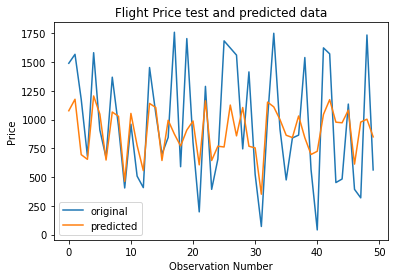

In [52]:
# Plotting the graph of actual price vs predicted price
number_of_observations=50
x_ax = range(len(y_test[:number_of_observations]))
plt.plot(x_ax, y_test[:number_of_observations], label="original")
plt.plot(x_ax, yPred_Regression[:number_of_observations], label="predicted")
plt.title("Flight Price test and predicted data")
plt.xlabel('Observation Number')
plt.ylabel('Price')
plt.legend()
plt.show()

In [53]:
# Importing LazyPredict library in order check the accuracy of differnet models
from lazypredict.Supervised import LazyRegressor
reg = LazyRegressor(verbose=0, ignore_warnings=False, custom_metric=None)
models, predictions = reg.fit(x_train, x_test, y_train, y_test)
models.head(10)

 21%|██▏       | 9/42 [00:06<00:31,  1.06it/s]

GammaRegressor model failed to execute
Some value(s) of y are out of the valid range for family GammaDistribution


100%|██████████| 42/42 [01:24<00:00,  2.00s/it]


,Adjusted R-Squared,R-Squared,RMSE,Time Taken
Model,,,,
RandomForestRegressor,0.68,0.69,282.50,6.50
ExtraTreesRegressor,0.68,0.68,284.40,4.53
XGBRegressor,0.65,0.66,295.65,0.99
BaggingRegressor,0.65,0.65,295.91,0.72
LGBMRegressor,0.64,0.64,302.37,0.49
HistGradientBoostingRegressor,0.63,0.64,304.13,3.78
DecisionTreeRegressor,0.45,0.46,370.52,0.14
KNeighborsRegressor,0.44,0.44,376.84,0.96
ExtraTreeRegressor,0.42,0.42,383.06,0.08


In [54]:
# Selecting the model from the output from the lazypredict and fitting the training data
from sklearn.ensemble import ExtraTreesRegressor
model =  ExtraTreesRegressor()
model.fit(x_train,y_train)

ExtraTreesRegressor()

In [55]:
# Predicting the price for test dataset 
y_pred_ETR =  model.predict(x_test)
print('Training Score :',model.score(x_train, y_train))
print('Test Score     :',model.score(x_test, y_test))

Training Score : 0.9855321908483471
Test Score     : 0.6755087588173154


In [56]:
# Converting the predicted values to dataframe
ETR=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred_ETR})
ETR

# Creating the csv file
ETR.to_csv('PredictedValuesETR.csv',index=False)

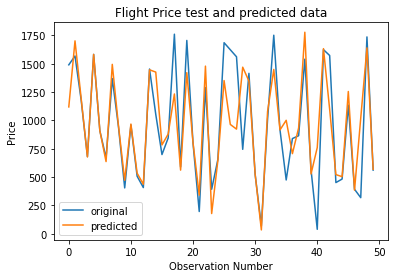

In [57]:
# Plotting the graph of actual price vs predicted price
number_of_observations=50
x_ax = range(len(y_test[:number_of_observations]))
plt.plot(x_ax, y_test[:number_of_observations], label="original")
plt.plot(x_ax, y_pred_ETR[:number_of_observations], label="predicted")
plt.title("Flight Price test and predicted data")
plt.xlabel('Observation Number')
plt.ylabel('Price')
plt.legend()
plt.show()

In [59]:
# Selecting the model from the output from the lazypredict and fitting the training data
from xgboost import XGBRegressor
model =  XGBRegressor()
model.fit(x_train,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [60]:
y_pred_XGB =  model.predict(x_test)
print('Training Score :',model.score(x_train, y_train))
print('Test Score     :',model.score(x_test, y_test))

Training Score : 0.8912613407034948
Test Score     : 0.6553061549442608


In [61]:
# Converting the predicted values to dataframe
XGB=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred_XGB})
XGB

# Creating the csv file
XGB.to_csv('PredictedValuesXGB.csv',index=False)

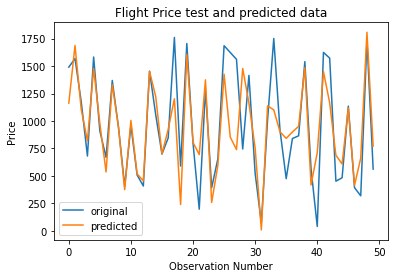

In [62]:
number_of_observations=50
x_ax = range(len(y_test[:number_of_observations]))
plt.plot(x_ax, y_test[:number_of_observations], label="original")
plt.plot(x_ax, y_pred_XGB[:number_of_observations], label="predicted")
plt.title("Flight Price test and predicted data")
plt.xlabel('Observation Number')
plt.ylabel('Price')
plt.legend()
plt.show()